In [1]:
import os
import pickle
import pyBigWig
import numpy as np
import pandas as pd
import scipy.stats
import seaborn as sns
import matplotlib.pyplot as plt

dataset_dir = "../dataset/new/"
biosamples = ["A549", "GM12878", "K562"]
HMs = ["H3K4me3", "H3K27ac", "H3K4me1", "H3K36me3", "H3K9me3", "H3K27me3"]

biosample = biosamples[2]
x_hm = HMs[0]
y_hm = HMs[1]
chr_ith = "chr1"

constrain = True
thres = 5

In [2]:
with open(dataset_dir+"{}/{}.pkl".format(biosample, biosample), "rb") as f:
    temp = pickle.load(f)

if constrain:
    scope_x = temp[x_hm][chr_ith] <= thres
    scope_y = temp[y_hm][chr_ith] <= thres
    # scope = np.logical_not(scope_x & scope_y)
    scope = scope_x & scope_y
    scope = np.where(scope)
#     scope = list(not(set(scope_x[0]) & set(scope_y[0])))
else:
    scope = ...

x = temp[x_hm][chr_ith][scope]
y = temp[y_hm][chr_ith][scope]

print("Scope size : {}/{}".format(len(x), len(temp[x_hm][chr_ith])))
print("Pearson corr :", scipy.stats.pearsonr(x, y)[0])
print("Spearman corr :", scipy.stats.spearmanr(x, y)[0])

# print("Median : x -- {}, y -- {}".format(np.median(x), np.median(y)))
# p = 0.8
# print("Quantile {} : x -- {}, y -- {}".format(p, np.quantile(x,p), np.quantile(y,p)))

Scope size : 243259/248957
Pearson corr : 0.2453602117633193
Spearman corr : 0.23010296927757082


In [4]:
pear = []
spear = []
for HM in HMs:
    p_r = []
    s_r = []
    x = temp[HM]["chr"+str(1)]
    for ith in list(range(2,23))+["X"]:
        x = np.concatenate((x, temp[HM]["chr"+str(ith)]))
    scope_x = x <= 1
    for HM in HMs:
        y = temp[HM]["chr"+str(1)]
        for ith in list(range(2,23))+["X"]:
            y = np.concatenate((y, temp[HM]["chr"+str(ith)]))
        scope_y = y <= 1
        scope = np.logical_not(scope_x & scope_y)
        scope = np.where(scope)
        p_r.append(scipy.stats.pearsonr(x[scope], y[scope])[0])
        s_r.append(scipy.stats.spearmanr(x[scope], y[scope])[0])
    pear.append(p_r)
    spear.append(s_r)

Text(0.5, -0.1, 'Bin size : 1000')

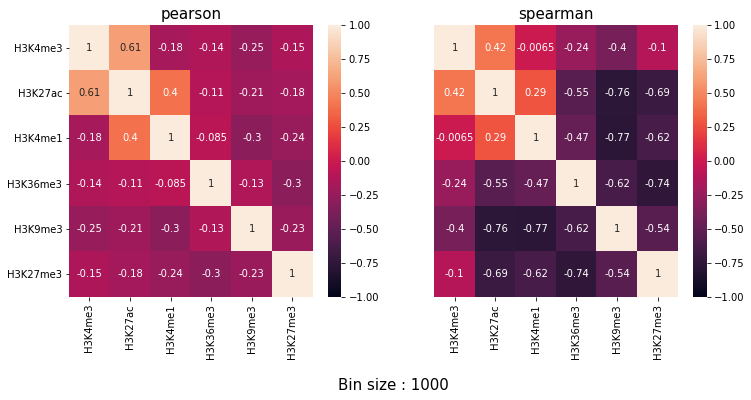

In [5]:
fig, axs = plt.subplots(1, 2, figsize=(12, 5))
corr_types = ["pearson", "spearman"]
for ith, corr_type in enumerate(corr_types):
    axs[ith].set_title(corr_type, fontsize=15)
    if ith == 0:
        sns.heatmap(pear, vmin=-1, vmax=1, ax=axs[ith], annot=True, xticklabels=HMs, yticklabels=HMs)
    else:
        sns.heatmap(spear, vmin=-1, vmax=1, ax=axs[ith], annot=True, xticklabels=HMs, yticklabels=False)

fig.suptitle("Bin size : 1000", fontsize=15, x=0.5, y=-0.1)

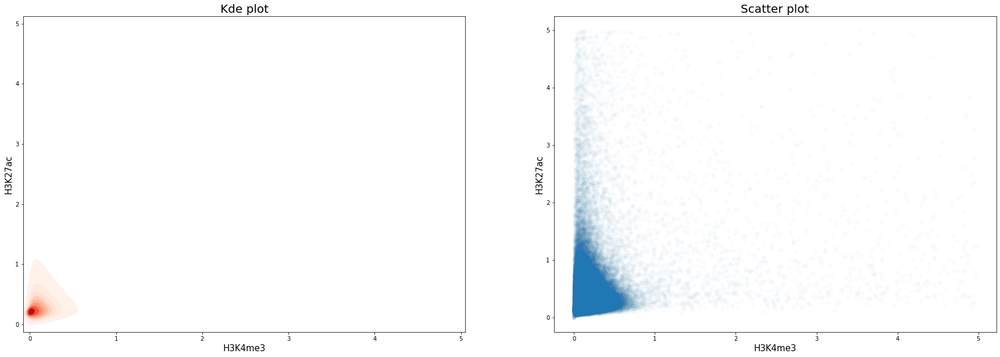

In [3]:
df = pd.DataFrame({"x_hm":x, "y_hm":y})

fig, axs = plt.subplots(1, 2, figsize=(30, 10))
plot_types = ["Kde plot", "Scatter plot"]
for ith, plot_type in enumerate(plot_types):
    axs[ith].set_title(plot_type, fontsize=20)
    if ith == 0:
        sns.kdeplot(data=df, x="x_hm", y="y_hm", ax=axs[ith], cmap="Reds", fill=True)
        axs[ith].set_xlabel(x_hm, fontsize=15)
        axs[ith].set_ylabel(y_hm, fontsize=15)
    else:
        axs[ith].scatter(x, y, alpha=0.02)
        axs[ith].set_xlabel(x_hm, fontsize=15)
        axs[ith].set_ylabel(y_hm, fontsize=15)


plt.savefig("/home/huan/Desktop/test.png")



# plt.figure(figsize=(15,10))
# # plt.xlim([-1,100])
# # plt.ylim([-1,20])
# sns.kdeplot(data=df, x="x_hm", y="y_hm", cmap="Reds", fill=True)
# plt.xlabel(x_hm, fontsize=15)
# plt.ylabel(y_hm, fontsize=15)
# # sns.jointplot(data=df, x="x_hm", y="y_hm", cmap="Blues", shade=True, kind='kde')
# plt.figure(figsize=(15,10))

# plt.scatter(x, y, alpha=0.02)
# plt.xlabel(x_hm, fontsize=15)
# plt.ylabel(y_hm, fontsize=15)
# plt.figure(figsize=(15,10))